In [1]:
import os
import shutil
import random
import pandas as pd

In [2]:
# Path to the extracted CSV file
metadata_path = "isic-2024-challenge/train-metadata.csv"

# Load the metadata into a pandas DataFrame
df = pd.read_csv(metadata_path)

C:\Users\TimPr\AppData\Local\Temp\ipykernel_28684\3092520799.py:5: DtypeWarning: Columns (51,52) have mixed types. Specify dtype option on import or set low_memory=False.
  df = pd.read_csv(metadata_path)


In [6]:
df.columns

Index(['isic_id', 'target', 'patient_id', 'age_approx', 'sex',
       'anatom_site_general', 'clin_size_long_diam_mm', 'image_type',
       'tbp_tile_type', 'tbp_lv_A', 'tbp_lv_Aext', 'tbp_lv_B', 'tbp_lv_Bext',
       'tbp_lv_C', 'tbp_lv_Cext', 'tbp_lv_H', 'tbp_lv_Hext', 'tbp_lv_L',
       'tbp_lv_Lext', 'tbp_lv_areaMM2', 'tbp_lv_area_perim_ratio',
       'tbp_lv_color_std_mean', 'tbp_lv_deltaA', 'tbp_lv_deltaB',
       'tbp_lv_deltaL', 'tbp_lv_deltaLB', 'tbp_lv_deltaLBnorm',
       'tbp_lv_eccentricity', 'tbp_lv_location', 'tbp_lv_location_simple',
       'tbp_lv_minorAxisMM', 'tbp_lv_nevi_confidence', 'tbp_lv_norm_border',
       'tbp_lv_norm_color', 'tbp_lv_perimeterMM',
       'tbp_lv_radial_color_std_max', 'tbp_lv_stdL', 'tbp_lv_stdLExt',
       'tbp_lv_symm_2axis', 'tbp_lv_symm_2axis_angle', 'tbp_lv_x', 'tbp_lv_y',
       'tbp_lv_z', 'attribution', 'copyright_license', 'lesion_id',
       'iddx_full', 'iddx_1', 'iddx_2', 'iddx_3', 'iddx_4', 'iddx_5',
       'mel_mitotic_index', '

In [8]:
df.iddx_full.unique()

array(['Benign',
       'Benign::Benign epidermal proliferations::Lichen planus like keratosis',
       'Benign::Benign melanocytic proliferations::Nevus::Nevus, NOS, Junctional',
       'Malignant::Malignant epidermal proliferations::Squamous cell carcinoma in situ',
       'Benign::Benign melanocytic proliferations::Nevus',
       'Malignant::Malignant adnexal epithelial proliferations - Follicular::Basal cell carcinoma::Basal cell carcinoma, Nodular',
       'Malignant::Malignant epidermal proliferations::Squamous cell carcinoma, Invasive',
       'Indeterminate::Indeterminate epidermal proliferations::Solar or actinic keratosis',
       'Benign::Benign epidermal proliferations::Seborrheic keratosis',
       'Benign::Benign melanocytic proliferations::Nevus::Nevus, Atypical, Dysplastic, or Clark',
       'Malignant::Malignant adnexal epithelial proliferations - Follicular::Basal cell carcinoma::Basal cell carcinoma, Superficial',
       'Indeterminate::Indeterminate melanocytic prol

In [4]:
# Get the unique patient_ids where target == 1
unique_ids_target_1 = df[df['target'] == 1].index.unique()
unique_ids_target_0 = df[df['target'] == 0].index.unique()


In [5]:
# List of dummy-encoded category columns
category_columns = [
    'category_Epidermal proliferations (SCC)',
    'category_Melanocytic proliferations (Melanoma)',
    'category_Melanoma in situ',
    'category_Melanoma invasive',
    'category_benign'
]

# Dictionary to store unique IDs for each category
unique_ids_by_category = {}

# Get unique IDs for each category
for category in category_columns:
    # Filter rows where the category column is True
    unique_ids = df[df[category] == True].index.unique()
    unique_ids_by_category[category] = unique_ids

# Print the unique IDs for each category
for category, ids in unique_ids_by_category.items():
    print(f"Unique IDs for {category}: {ids}")

Unique IDs for category_Epidermal proliferations (SCC): Index([   387,   1846,  12742,  14532,  15469,  24099,  29299,  43326,  46166,
        48245,  65631,  73241,  78846,  81522,  90669, 109557, 118241, 122944,
       136860, 139086, 141606, 143395, 151409, 153898, 155486, 175473, 180894,
       182742, 185642, 186599, 188645, 191486, 194003, 196191, 204466, 213460,
       214765, 217873, 229126, 229289, 230120, 247497, 248412, 248590, 249502,
       251090, 254105, 257591, 261263, 265953, 271469, 280558, 282583, 287214,
       292033, 296186, 299784, 304160, 306984, 312043, 313430, 324402, 335512,
       336204, 336497, 337632, 339771, 340627, 352436, 356461, 359177, 368546,
       399936],
      dtype='int64')
Unique IDs for category_Melanocytic proliferations (Melanoma): Index([ 10732,  15163,  70132,  79002,  80682,  88471,  91807, 133337, 161599,
       173790, 210905, 238777, 333377, 382854],
      dtype='int64')
Unique IDs for category_Melanoma in situ: Index([  6057,   8204,

In [8]:
# Define the path to your images and the target folder
image_folder = "C:/Users/TimPr/allcode/Pytorch/kaggle_comp/isic-2024-challenge/train-image/image/"
target_1_folder = "C:/Users/TimPr/allcode/Pytorch/kaggle_comp/isic-2024-challenge/train_folder/target_1/"

# Make sure the target_1 folder exists, if not, create it
os.makedirs(target_1_folder, exist_ok=True)

# Move all target 1 images
for image_id in unique_ids_target_1:
    image_path = os.path.join(image_folder, f"{image_id}.jpg")
    if os.path.exists(image_path):
        shutil.move(image_path, os.path.join(target_1_folder, f"{image_id}.jpg"))
    else:
        print(f"Image {image_id}.jpg not found.")


Image 387.jpg not found.
Image 935.jpg not found.
Image 1245.jpg not found.
Image 1846.jpg not found.
Image 3478.jpg not found.
Image 4812.jpg not found.
Image 5673.jpg not found.
Image 6057.jpg not found.
Image 6741.jpg not found.
Image 8204.jpg not found.
Image 8347.jpg not found.
Image 8676.jpg not found.
Image 8920.jpg not found.
Image 10041.jpg not found.
Image 10400.jpg not found.
Image 10472.jpg not found.
Image 10732.jpg not found.
Image 12742.jpg not found.
Image 12982.jpg not found.
Image 14532.jpg not found.
Image 15163.jpg not found.
Image 15469.jpg not found.
Image 16053.jpg not found.
Image 18231.jpg not found.
Image 18518.jpg not found.
Image 18538.jpg not found.
Image 19551.jpg not found.
Image 20007.jpg not found.
Image 23053.jpg not found.
Image 24099.jpg not found.
Image 24133.jpg not found.
Image 25548.jpg not found.
Image 25764.jpg not found.
Image 26382.jpg not found.
Image 27945.jpg not found.
Image 28079.jpg not found.
Image 28354.jpg not found.
Image 29299.jpg 

In [ ]:
target_0_folder = "C:/Users/TimPr/allcode/Pytorch/kaggle_comp/isic-2024-challenge/train_folder/target_0/"

# Make sure the target_1 folder exists, if not, create it
os.makedirs(target_0_folder, exist_ok=True)

# Move all target 1 images
for image_id in unique_ids_target_0:
    image_path = os.path.join(image_folder, f"{image_id}.jpg")
    if os.path.exists(image_path):
        shutil.move(image_path, os.path.join(target_0_folder, f"{image_id}.jpg"))
    else:
        print(f"Image {image_id}.jpg not found.")

Image 0.jpg not found.
Image 1.jpg not found.
Image 2.jpg not found.
Image 3.jpg not found.
Image 4.jpg not found.
Image 5.jpg not found.
Image 6.jpg not found.
Image 7.jpg not found.
Image 8.jpg not found.
Image 9.jpg not found.
Image 10.jpg not found.
Image 11.jpg not found.
Image 12.jpg not found.
Image 13.jpg not found.
Image 14.jpg not found.
Image 15.jpg not found.
Image 16.jpg not found.
Image 17.jpg not found.
Image 18.jpg not found.
Image 19.jpg not found.
Image 20.jpg not found.
Image 21.jpg not found.
Image 22.jpg not found.
Image 23.jpg not found.
Image 24.jpg not found.
Image 25.jpg not found.
Image 26.jpg not found.
Image 27.jpg not found.
Image 28.jpg not found.
Image 29.jpg not found.
Image 30.jpg not found.
Image 31.jpg not found.
Image 32.jpg not found.
Image 33.jpg not found.
Image 34.jpg not found.
Image 35.jpg not found.
Image 36.jpg not found.
Image 37.jpg not found.
Image 38.jpg not found.
Image 39.jpg not found.
Image 40.jpg not found.
Image 41.jpg not found.
Im

In [ ]:
# import os
# import shutil
# import random

# # Define the source and destination folders
# source_folder = "C:/Users/TimPr/allcode/Pytorch/kaggle_comp/isic-2024-challenge/train_folder_multiclass/target_0/"
# destination_folder = "C:/Users/TimPr/allcode/Pytorch/kaggle_comp/isic-2024-challenge/train_folder/target_0/"

# # Ensure the destination folder exists
# os.makedirs(destination_folder, exist_ok=True)

# # Get a list of all image files in the source folder
# image_files = [f for f in os.listdir(source_folder) if f.endswith('.jpg')]

# # Check if there are enough images to sample
# if len(image_files) < 2500:
#     raise ValueError(f"Not enough images in the source folder. Required: 2500, Available: {len(image_files)}")

# # Randomly select 2500 images
# selected_images = random.sample(image_files, 2500)

# # Copy the selected images to the destination folder
# for image in selected_images:
#     source_path = os.path.join(source_folder, image)
#     destination_path = os.path.join(destination_folder, image)
#     shutil.copy(source_path, destination_path)

# print(f"Copied {len(selected_images)} images to {destination_folder}.")

In [4]:
import os
import shutil

# Define the source and destination folders
source_folder = "C:/Users/TimPr/allcode/Pytorch/kaggle_comp/isic-2024-challenge/train_folder_multiclass/target_0/"
destination_folder = "C:/Users/TimPr/allcode/Pytorch/kaggle_comp/isic-2024-challenge/train_folder/target_0/"

# Ensure the destination folder exists
os.makedirs(destination_folder, exist_ok=True)

# Get a list of all image files in the source folder
image_files = [f for f in os.listdir(source_folder) if f.endswith('.jpg')]

# Move all images from the source to the destination folder
for image in image_files:
    source_path = os.path.join(source_folder, image)
    destination_path = os.path.join(destination_folder, image)
    shutil.move(source_path, destination_path)

print(f"Moved {len(image_files)} images to {destination_folder}.")


Moved 400666 images to C:/Users/TimPr/allcode/Pytorch/kaggle_comp/isic-2024-challenge/train_folder/target_0/.


In [5]:
# # Keep track of unique file names
# unique_files = set()

# # Iterate through files in the target folder
# for file_name in os.listdir(destination_folder):
#     file_path = os.path.join(destination_folder, file_name)
    
#     # Check if it's a file and if the file name is unique
#     if os.path.isfile(file_path):
#         if file_name in unique_files:
#             # Delete the duplicate file
#             os.remove(file_path)
#             print(f"Deleted duplicate: {file_path}")
#         else:
#             # Add the file name to the set of unique files
#             unique_files.add(file_name)

# print(f"Finished removing duplicates in {destination_folder}.")

Finished removing duplicates in C:/Users/TimPr/allcode/Pytorch/kaggle_comp/isic-2024-challenge/train_folder/target_0/.


## extra data:

In [17]:
import os
import shutil
import pandas as pd

def organize_images_by_target(folder_path):
    """
    Organizes images into target-specific folders (target_0 and target_1) based on metadata.

    Args:
        folder_path (str): Path to the main folder containing metadata and image folder.

    Assumes:
        - Metadata CSV is in the main folder.
        - Images are in a subfolder named 'train-image'.
        - Metadata CSV has 'isic_id' and 'target' columns.
    """
    # Define paths
    metadata_file = os.path.join(folder_path, "train-metadata.csv")
    image_folder = os.path.join(folder_path, "train-image/image")
    target_0_folder = os.path.join(folder_path, "target_0")
    target_1_folder = os.path.join(folder_path, "target_1")
    
    # Create target folders if they don't exist
    os.makedirs(target_0_folder, exist_ok=True)
    os.makedirs(target_1_folder, exist_ok=True)
    
    # Read metadata
    metadata = pd.read_csv(metadata_file)
    
    # Iterate through metadata and move images
    for _, row in metadata.iterrows():
        isic_id = row['isic_id']  # Get ISIC ID
        target = row['target']    # Get target
        
        # Determine source and destination paths
        source_path = os.path.join(image_folder, f"{isic_id}.jpg")
        if target == 0:
            dest_path = os.path.join(target_0_folder, f"{isic_id}.jpg")
        elif target == 1:
            dest_path = os.path.join(target_1_folder, f"{isic_id}.jpg")
        else:
            continue  # Skip if target is invalid
        
        # Move image if it exists
        if os.path.exists(source_path):
            shutil.move(source_path, dest_path)
        else:
            print(f"Image {isic_id}.jpg not found in {image_folder}.")
    
    print("Images successfully organized into target folders.")

# Example usage
organize_images_by_target(r"C:\Users\TimPr\allcode\Pytorch\kaggle_comp\isic-2024-challenge\extra_train\isic-2020-jpg-256x256-resized\versions\1")
organize_images_by_target(r"C:\Users\TimPr\allcode\Pytorch\kaggle_comp\isic-2024-challenge\extra_train\isic-2019-jpg-256x256-resized\versions\1")
organize_images_by_target(r"C:\Users\TimPr\allcode\Pytorch\kaggle_comp\isic-2024-challenge\extra_train\isic-2018-jpg-256x256-resized\versions\1")


Image ISIC_2637011.jpg not found in C:\Users\TimPr\allcode\Pytorch\kaggle_comp\isic-2024-challenge\extra_train\isic-2020-jpg-256x256-resized\versions\1\train-image/image.
Image ISIC_0015719.jpg not found in C:\Users\TimPr\allcode\Pytorch\kaggle_comp\isic-2024-challenge\extra_train\isic-2020-jpg-256x256-resized\versions\1\train-image/image.
Image ISIC_0052212.jpg not found in C:\Users\TimPr\allcode\Pytorch\kaggle_comp\isic-2024-challenge\extra_train\isic-2020-jpg-256x256-resized\versions\1\train-image/image.
Image ISIC_0068279.jpg not found in C:\Users\TimPr\allcode\Pytorch\kaggle_comp\isic-2024-challenge\extra_train\isic-2020-jpg-256x256-resized\versions\1\train-image/image.
Image ISIC_0074268.jpg not found in C:\Users\TimPr\allcode\Pytorch\kaggle_comp\isic-2024-challenge\extra_train\isic-2020-jpg-256x256-resized\versions\1\train-image/image.
Image ISIC_0074311.jpg not found in C:\Users\TimPr\allcode\Pytorch\kaggle_comp\isic-2024-challenge\extra_train\isic-2020-jpg-256x256-resized\vers

In [4]:
!pip install cv2

ERROR: Could not find a version that satisfies the requirement cv2 (from versions: none)
ERROR: No matching distribution found for cv2
You should consider upgrading via the 'C:\Users\TimPr\allcode\Pytorch\.venv\Scripts\python.exe -m pip install --upgrade pip' command.


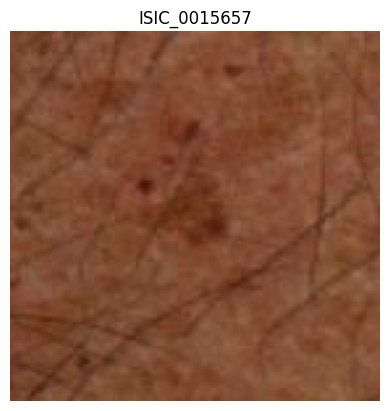

In [6]:
import h5py
import matplotlib.pyplot as plt
import numpy as np
from PIL import Image
import io

# Path to your HDF5 file
file_path = r"C:\Users\TimPr\allcode\Pytorch\kaggle_comp\isic-2024-challenge\test-image.hdf5"

# Open the HDF5 file
with h5py.File(file_path, "r") as f:
    for isic_id in f.keys():  # Iterate through all image keys
        raw_data = f[isic_id][()]  # Read image data
        
        # Convert bytes to image using PIL
        try:
            image = Image.open(io.BytesIO(raw_data))  # Decode image
        except:
            print(f"Skipping {isic_id}: Unable to decode")
            continue
        
        # Display the image
        plt.imshow(image)
        plt.axis("off")
        plt.title(isic_id)  # Show ISIC ID as title
        plt.show()

        break  # Remove this to display all images
